# 목차
- STEP 1. 작업환경 구성하기
- STEP 2. 데이터셋 구성하기
- STEP 3. 생성자 모델 구현하기
- STEP 4. 판별자 모델 구현하기
- STEP 5. 손실함수와 최적화 함수 구현하기
- STEP 6. 훈련과정 상세 기능 구현하기
- STEP 7. 학습 과정 진행하기
- **STEP 8. (optional) GAN 훈련 과정 개선하기**

## STEP 8. (optional) GAN 훈련 과정 개선하기
- STEP 6을 진행하면서 생성된 샘플 이미지, 학습 과정 그래프 등을 통해 이전 훈련 과정의 문제점을 분석해 봅시다.
- 모델구조 또는 학습 과정을 개선한 내역과 그 결과(샘플 이미지, 학습 과정 그래프 포함)를 함께 제출합니다.

### 1. ver2
**[ 주요 개선 사항 ]**
- 데이터셋을 3개 클래스로 필터링
- Learning Rate 감소 (1e-4 → 1e-5)
- 판별자 Label Smoothing 적용 (진짜 라벨을 1 → 0.9) : 생성자에 학습 기회 더 제공
- 판별자의 Dropout 비율 증가 (0.3 → 0.5) : 판별자의 과적합 방지(판별자가 과도하게 확신하는 현상 감소)
- LeakyReLU의 alpha 값 변경 (0.2로 좀 더 부드럽게) : 기울기가 0에 너무 가까워지지 않아 죽은 뉴런 문제 방지
- Spectral Normalization 적용 : 판별자의 가중치가 너무 커지는(폭주) 문제 방지
- 훈련 주기 조정 : 판별자만 주기적으로 학습
- He Initialization 적용 : 가중치가 작은 값으로 시작해 학습이 더 안정적으로 진행(Generator 초기화 개선)
- BatchNorm의 momentum 값 변경 (0.99 → 0.9) : 학습의 민감도 증가

In [1]:
import os
import glob
import time
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import imageio
from IPython.display import display, Image, clear_output
import pandas as pd

# 경고 무시
import warnings
warnings.filterwarnings('ignore')

In [2]:
# 디렉토리 설정
sample_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/generated_samples_ver2')
history_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/training_history_ver2')
checkpoint_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/training_checkpoints_ver2')

os.makedirs(sample_dir, exist_ok=True)
os.makedirs(history_dir, exist_ok=True)
os.makedirs(checkpoint_dir, exist_ok=True)

In [3]:
# 주요 환경 설정
BUFFER_SIZE = 50000
BATCH_SIZE = 256
EPOCHS = 50
SAVE_EVERY = 2
NUM_CLASSES = 3 # 3개 클래스만 선택
NOISE_DIM = 100

In [4]:
# 1. 데이터셋 필터링
def load_filtered_data():
    (train_x, train_y), _ = tf.keras.datasets.cifar10.load_data()
    
    selected_classes = list(range(NUM_CLASSES))
    filter_mask = np.isin(train_y.flatten(), selected_classes)
    
    filtered_train_x = train_x[filter_mask]
    return filtered_train_x

train_x = load_filtered_data()
train_x = (train_x - 127.5) / 127.5  # 정규화 (-1 ~ 1)

train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [5]:
# 2. 생성자 모델 개선
def make_generator_model():
    model = tf.keras.Sequential([
        layers.Dense(8 * 8 * 256, use_bias=False, input_shape=(100,)),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Reshape((8, 8, 256)),
        layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False, kernel_initializer='he_normal'),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False, kernel_initializer='he_normal'),
        layers.BatchNormalization(momentum=0.9),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2DTranspose(3, (5, 5), strides=(1, 1), padding='same', use_bias=False, activation='tanh')
    ])
    return model

generator = make_generator_model()

In [6]:
# 3. 판별자 모델 개선 (Spectral Normalization + Dropout 강화)
def make_discriminator_model():
    model = tf.keras.Sequential([
        layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.5),

        layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.5),

        layers.Flatten(),
        layers.Dense(1)
    ])
    return model

discriminator = make_discriminator_model()

In [7]:
# 4. 손실함수 개선 (Label Smoothing 적용)
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output) * 0.9, real_output)  # Label Smoothing
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

# 5. 옵티마이저 개선 (학습률 감소)
generator_optimizer = tf.keras.optimizers.Adam(1e-5, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-5, beta_1=0.5)

# 6. 샘플용 Seed
seed = tf.random.normal([16, NOISE_DIM])

In [8]:
# 7. 학습 함수 개선
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)
        
        real_accuracy = tf.reduce_mean(tf.cast(real_output > 0.5, tf.float32))
        fake_accuracy = tf.reduce_mean(tf.cast(fake_output < 0.5, tf.float32))

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [9]:
# 8. 이미지 생성 및 저장
def generate_and_save_images(model, epoch, it, sample_seeds):
    predictions = model(seed, training=False)
    
    plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow((predictions[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')

    save_path = f'{os.getenv("HOME")}/aiffel/dcgan_newimage/cifar10/generated_samples_ver2/sample_epoch_{epoch:04d}_iter_{it:03d}.png'
    plt.savefig(save_path)
    plt.close()

In [10]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6 # matlab 차트 크기를 15,6으로 지정

def draw_train_history(history, epoch):
    fig, axs = plt.subplots(2, 1)
    
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # tepoch별 그래프를 이미지 파일로 저장
    save_path = '{}/aiffel/dcgan_newimage/cifar10/training_history_ver2/train_history_{:04d}.png'.format(os.getenv('HOME'), epoch)
    plt.savefig(save_path)
    plt.close(fig)

In [11]:
checkpoint_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/training_checkpoints_ver2')
os.makedirs(checkpoint_dir, exist_ok=True)

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [12]:
# 9. 학습 진행
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)
        
train(train_dataset, EPOCHS, SAVE_EVERY)

Time for training : 400 sec


### 2. ver3
**[ 주요 개선 사항 ]**
"Improved Techniques for Training GANs" 논문 참조

- One-sided Label Smoothing: 판별자의 라벨을 1이 아닌 0.9로 설정하여 학습 안정성 향상
- Learning Rate 및 Optimizer 개선: Adam 옵티마이저에 적절한 파라미터 적용
- **+ Minibatch Discrimination: 판별자에 Minibatch Discrimination 레이어를 추가하여 모드 붕괴 방지**

In [1]:
import os
import glob
import time
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt
from IPython.display import Image, display, clear_output
import matplotlib.image as mpimg
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')  # 경고 메시지 무시

In [2]:
# 디렉토리 설정
sample_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/generated_samples_ver3')
history_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/training_history_ver3')
checkpoint_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/training_checkpoints_ver3')

os.makedirs(sample_dir, exist_ok=True)
os.makedirs(history_dir, exist_ok=True)
os.makedirs(checkpoint_dir, exist_ok=True)

In [3]:
# Hyperparameters
BUFFER_SIZE = 50000
BATCH_SIZE = 256
noise_dim = 100
num_examples_to_generate = 10
EPOCHS = 50
save_every = 5

In [4]:
# 데이터셋 로드 및 정규화
(train_x, _), (_, _) = tf.keras.datasets.cifar10.load_data()
train_x = (train_x - 127.5) / 127.5
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [5]:
# 모델 정의

# Generator with Virtual Batch Normalization
def make_generator_model():
    # Start
    model = tf.keras.Sequential([
        
        # First: Dense layer
        layers.Dense(8*8*256, use_bias=False, input_shape=(100,)),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        
        # Second: Reshape layer
        layers.Reshape((8, 8, 256)),
        
        # Third: Conv2DTranspose layer
        layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        
        # Fourth: Conv2DTranspose layer
        layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        
        # Fifth: Conv2DTranspose layer
        layers.Conv2DTranspose(3, (5, 5), strides=(1, 1), padding='same', use_bias=False, activation='tanh')
    ])
    return model

generator = make_generator_model()

generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16384)             1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16384)             0         
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 128)       819200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 128)       0

In [6]:
from tensorflow.keras import layers, initializers

class MinibatchDiscrimination(layers.Layer):
    def __init__(self, num_kernels, kernel_dim, **kwargs):
        super(MinibatchDiscrimination, self).__init__(**kwargs)
        self.num_kernels = num_kernels
        self.kernel_dim = kernel_dim

    def build(self, input_shape):
        # 논문에 따라 A×B×C 형태의 T 텐서 생성
        self.T = self.add_weight(
            name='kernel',
            shape=(input_shape[1], self.num_kernels, self.kernel_dim),
            initializer=initializers.RandomNormal(stddev=0.02),
            trainable=True
        )

    def call(self, inputs):
        # 1. 입력 벡터에 T 텐서 곱하기 → (batch_size, num_kernels, kernel_dim)
        M = tf.tensordot(inputs, self.T, axes=1)

        # 2. 샘플 간 L1 Distance 계산
        M_expanded1 = tf.expand_dims(M, 3)  # (batch_size, num_kernels, kernel_dim, 1)
        M_expanded2 = tf.expand_dims(tf.transpose(M, [1, 2, 0]), 0)  # (1, num_kernels, kernel_dim, batch_size)

        # 3. L1 거리 계산 → (batch_size, num_kernels, batch_size)
        abs_diffs = tf.reduce_sum(tf.abs(M_expanded1 - M_expanded2), axis=2)

        # 4. Negative exponential 적용 → (batch_size, num_kernels, batch_size)
        c = tf.exp(-abs_diffs)

        # 5. Minibatch feature 생성 (다른 샘플과의 유사성 총합)
        o = tf.reduce_sum(c, axis=2)

        # 6. 원본 입력 벡터와 Minibatch feature를 결합
        return tf.concat([inputs, o], axis=1)

# Discriminator with Minibatch Discrimination
def make_discriminator_model():
    # Start
    model = tf.keras.Sequential([
        
        # First: Conv2D Layer
        layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        
        # Second: Conv2D Layer
        layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        
        # Third: Flatten Layer
        layers.Flatten(),        

        # Minibatch Discrimination 적용
        MinibatchDiscrimination(num_kernels=50, kernel_dim=5),
        
        # Fifth: Dense Layer
        layers.Dense(1) # 판별결과 출력(1에 가까우면 진짜, 0에 가까우면 가짜라고 판별)
    ])
    return model

discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 64)        4864      
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 16, 16, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 128)         204928    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 8, 8, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 8192)             

In [7]:
# Loss & Optimizer with One-sided Label Smoothing

# 손실 함수 정의
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# 생성자의 손실 함수 
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# 판별자의 손실 함수
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output) * 0.9, real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

# 판별자의 정확도(accuracy) 계산 함수
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(real_output > 0.5, tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(fake_output < 0.5, tf.float32))
    return real_accuracy, fake_accuracy

generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

# Checkpoint 설정
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [8]:
# Training Step
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        # 정확도 계산 (0.5 기준으로 판단)
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    return gen_loss, disc_loss, real_accuracy, fake_accuracy

In [9]:
# Training & Saving Process

from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6 # matlab 차트 크기를 15,6으로 지정

# 학습 진행 그래프 저장
def draw_train_history(history, epoch):
    fig, axs = plt.subplots(2, 1)
    
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # tepoch별 그래프를 이미지 파일로 저장
    save_path = '{}/aiffel/dcgan_newimage/cifar10/training_history_ver3/train_history_{:04d}.png'.format(os.getenv('HOME'), epoch)
    plt.savefig(save_path)
    plt.close(fig)

# 랜덤 노이즈 시드 생성 (샘플 이미지 저장용)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# 샘플 이미지 생성 및 저장 함수
def generate_and_save_images(model, epoch, it, sample_seeds):
    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')

    # 이미지 저장 경로
    save_path = os.path.join(sample_dir, f'sample_epoch_{epoch:04d}_iter_{it:03d}.png')
    plt.savefig(save_path)
    plt.close(fig)

In [10]:
# Training Function
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

# 학습 실행
train(train_dataset, EPOCHS, save_every)

Time for training : 1324 sec


In [11]:
def save_gif(image_folder, output_gif_path, duration=0.1):
    # 이미지 파일 경로 가져오기
    image_files = sorted(glob.glob(os.path.join(image_folder, '*.png')))

    # GIF로 저장
    with imageio.get_writer(output_gif_path, mode='I', duration=duration) as writer:
        for filename in image_files:
            image = imageio.imread(filename)
            writer.append_data(image)

    print(f"GIF saved at: {output_gif_path}")

GIF saved at: /aiffel/aiffel/dcgan_newimage/cifar10/generated_samples_ver3/cifar10_samples_ver3.gif


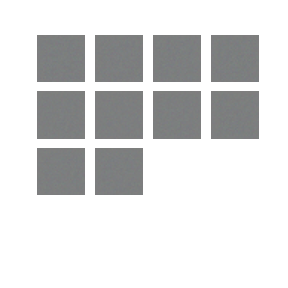

In [12]:
# 샘플 이미지 저장 및 GIF 생성
sample_gif_path = os.path.join(sample_dir, 'cifar10_samples_ver3.gif')
save_gif(sample_dir, sample_gif_path, duration=0.1)

# 결과 표시
display(Image(filename=sample_gif_path))

GIF saved at: /aiffel/aiffel/dcgan_newimage/cifar10/training_history_ver3/training_history_ver3.gif


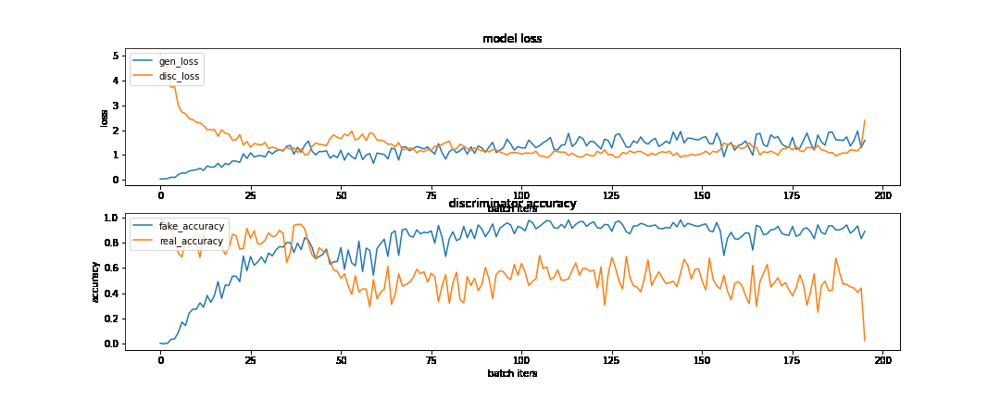

In [13]:
# 학습 그래프 저장 및 GIF 생성
history_gif_path = os.path.join(history_dir, 'training_history_ver3.gif')
save_gif(history_dir, history_gif_path, duration=0.1)

# 결과 표시
display(Image(filename=history_gif_path))

### 3. ver4
**[ 주요 개선 사항 ]**
"Improved Techniques for Training GANs" 논문 참조

- Minibatch Discrimination: 판별자에 Minibatch Discrimination 레이어를 추가하여 모드 붕괴 방지
- One-sided Label Smoothing: 판별자의 라벨을 1이 아닌 0.9로 설정하여 학습 안정성 향상
- Learning Rate 및 Optimizer 개선: Adam 옵티마이저에 적절한 파라미터 적용

- **+ Virtual Batch Normalization (VBN): 생성자에 VBN 적용**

In [3]:
import os
import glob
import time
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt
from IPython.display import Image, display, clear_output
import matplotlib.image as mpimg
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')  # 경고 메시지 무시

In [8]:
# 디렉토리 설정
sample_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/generated_samples_ver4')
history_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/training_history_ver4')
checkpoint_dir = os.path.join(os.getenv('HOME'), 'aiffel/dcgan_newimage/cifar10/training_checkpoints_ver4')

os.makedirs(sample_dir, exist_ok=True)
os.makedirs(history_dir, exist_ok=True)
os.makedirs(checkpoint_dir, exist_ok=True)

In [3]:
# Hyperparameters
BUFFER_SIZE = 50000
BATCH_SIZE = 256
noise_dim = 100
num_examples_to_generate = 16
EPOCHS = 50
save_every = 5

In [4]:
# 데이터셋 로드 및 정규화
(train_x, _), (_, _) = tf.keras.datasets.cifar10.load_data()
train_x = (train_x - 127.5) / 127.5
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [5]:
# Virtual Batch Normalization Layer
class VirtualBatchNormalization(layers.Layer):
    def __init__(self, ref_batch, epsilon=1e-5, name=None):
        super(VirtualBatchNormalization, self).__init__(name=name)
        self.epsilon = epsilon
        self.ref_batch = tf.cast(ref_batch, tf.float32)
        self.projection = None  # Projection layer to match channels

    def build(self, input_shape):
        channels = input_shape[-1]
        
        # Projection layer to match channels if needed
        self.projection = layers.Conv2D(channels, (1, 1), padding='same', use_bias=False)

        self.gamma = self.add_weight(shape=(channels,), initializer='ones', trainable=True, name='gamma')
        self.beta = self.add_weight(shape=(channels,), initializer='zeros', trainable=True, name='beta')

    def call(self, x):
        ref_batch_resized = tf.image.resize(self.ref_batch, (x.shape[1], x.shape[2]))
        ref_batch_projected = self.projection(ref_batch_resized)

        batch_mean, batch_var = tf.nn.moments(ref_batch_projected, axes=[0, 1, 2], keepdims=False)
        x_mean, x_var = tf.nn.moments(x, axes=[0, 1, 2], keepdims=False)

        mean = (batch_mean + x_mean) / 2
        var = (batch_var + x_var) / 2

        x_norm = (x - mean) / tf.sqrt(var + self.epsilon)
        return self.gamma * x_norm + self.beta

In [6]:
# Generator with Virtual Batch Normalization (Functional API)
def make_generator_model(ref_batch):
    input_layer = layers.Input(shape=(100,))

    x = layers.Dense(8*8*256, use_bias=False)(input_layer)
    x = layers.Reshape((8, 8, 256))(x)
    x = VirtualBatchNormalization(ref_batch)(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False)(x)
    x = VirtualBatchNormalization(ref_batch)(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False)(x)
    x = VirtualBatchNormalization(ref_batch)(x)
    x = layers.LeakyReLU()(x)

    output_layer = layers.Conv2DTranspose(3, (5, 5), strides=(1, 1), padding='same', use_bias=False, activation='tanh')(x)

    return tf.keras.Model(inputs=input_layer, outputs=output_layer)

# Reference Batch for VBN
reference_batch = next(iter(train_dataset))

# Generator 생성
generator = make_generator_model(reference_batch)
generator.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 100)]             0         
_________________________________________________________________
dense (Dense)                (None, 16384)             1638400   
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
virtual_batch_normalization  (None, 8, 8, 256)         1280      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 128)       819200    
_________________________________________________________________
virtual_batch_normalization_ (None, 16, 16, 128)       640   

In [7]:
from tensorflow.keras import layers, initializers

# Minibatch Discrimination Layer
class MinibatchDiscrimination(layers.Layer):
    def __init__(self, num_kernels, kernel_dim, name=None, **kwargs):
        super(MinibatchDiscrimination, self).__init__(name=name, **kwargs)
        self.num_kernels = num_kernels
        self.kernel_dim = kernel_dim

    def build(self, input_shape):
        self.T = self.add_weight(
            name='kernel',
            shape=(input_shape[1], self.num_kernels, self.kernel_dim),
            initializer=initializers.RandomNormal(stddev=0.02),
            trainable=True
        )

    def call(self, inputs):
        M = tf.tensordot(inputs, self.T, axes=1)
        M_expanded1 = tf.expand_dims(M, 3)
        M_expanded2 = tf.expand_dims(tf.transpose(M, [1, 2, 0]), 0)
        abs_diffs = tf.reduce_sum(tf.abs(M_expanded1 - M_expanded2), axis=2)
        c = tf.exp(-abs_diffs)
        o = tf.reduce_sum(c, axis=2)
        return tf.concat([inputs, o], axis=1)

In [8]:
# Discriminator with Minibatch Discrimination
def make_discriminator_model():
    model = tf.keras.Sequential([
        layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3], name='conv1'),
        layers.LeakyReLU(name='leakyrelu1'),
        layers.Dropout(0.3, name='dropout1'),

        layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same', name='conv2'),
        layers.LeakyReLU(name='leakyrelu2'),
        layers.Dropout(0.3, name='dropout2'),

        layers.Flatten(name='flatten'),
        MinibatchDiscrimination(num_kernels=50, kernel_dim=5, name='minibatch_discrimination'),
        layers.Dense(1, name='dense_output')
    ])
    return model

discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1 (Conv2D)               (None, 16, 16, 64)        4864      
_________________________________________________________________
leakyrelu1 (LeakyReLU)       (None, 16, 16, 64)        0         
_________________________________________________________________
dropout1 (Dropout)           (None, 16, 16, 64)        0         
_________________________________________________________________
conv2 (Conv2D)               (None, 8, 8, 128)         204928    
_________________________________________________________________
leakyrelu2 (LeakyReLU)       (None, 8, 8, 128)         0         
_________________________________________________________________
dropout2 (Dropout)           (None, 8, 8, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 8192)              0

In [9]:
# Loss & Optimizer
def generator_loss(fake_output):
    return tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(real_output) * 0.9, real_output)
    fake_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(real_output > 0.5, tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(fake_output < 0.5, tf.float32))
    return real_accuracy, fake_accuracy

generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [10]:
# Training Step with VBN
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy

In [11]:
# Training & Saving Process

from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6 # matlab 차트 크기를 15,6으로 지정

# 학습 진행 그래프 저장
def draw_train_history(history, epoch):
    fig, axs = plt.subplots(2, 1)
    
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # tepoch별 그래프를 이미지 파일로 저장
    save_path = '{}/aiffel/dcgan_newimage/cifar10/training_history_ver4/train_history_{:04d}.png'.format(os.getenv('HOME'), epoch)
    plt.savefig(save_path)
    plt.close(fig)

# 랜덤 노이즈 시드 생성 (샘플 이미지 저장용)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# 샘플 이미지 생성 및 저장 함수
def generate_and_save_images(model, epoch, it, sample_seeds):
    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')

    # 이미지 저장 경로
    save_path = os.path.join(sample_dir, f'sample_epoch_{epoch:04d}_iter_{it:03d}.png')
    plt.savefig(save_path)
    plt.close(fig)

In [ ]:
# Training Function
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

# 학습 실행
train(train_dataset, EPOCHS, save_every)

Time for training : 1641 sec


In [4]:
def save_gif(image_folder, output_gif_path, duration=0.1):
    # 이미지 파일 경로 가져오기
    image_files = sorted(glob.glob(os.path.join(image_folder, '*.png')))

    # GIF로 저장
    with imageio.get_writer(output_gif_path, mode='I', duration=duration) as writer:
        for filename in image_files:
            image = imageio.imread(filename)
            writer.append_data(image)

    print(f"GIF saved at: {output_gif_path}")

GIF saved at: /aiffel/aiffel/dcgan_newimage/cifar10/generated_samples_ver4/cifar10_samples_ver4.gif


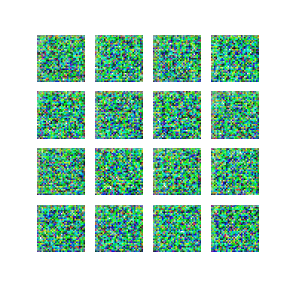

In [9]:
# 샘플 이미지 저장 및 GIF 생성
sample_gif_path = os.path.join(sample_dir, 'cifar10_samples_ver4.gif')
save_gif(sample_dir, sample_gif_path, duration=0.1)

# 결과 표시
display(Image(filename=sample_gif_path))

GIF saved at: /aiffel/aiffel/dcgan_newimage/cifar10/training_history_ver4/training_history_ver4.gif


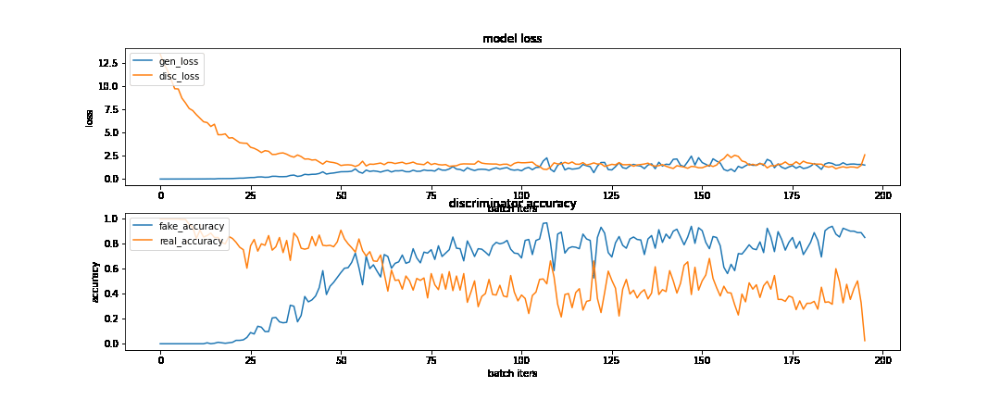

In [10]:
# 학습 그래프 저장 및 GIF 생성
history_gif_path = os.path.join(history_dir, 'training_history_ver4.gif')
save_gif(history_dir, history_gif_path, duration=0.1)

# 결과 표시
display(Image(filename=history_gif_path))

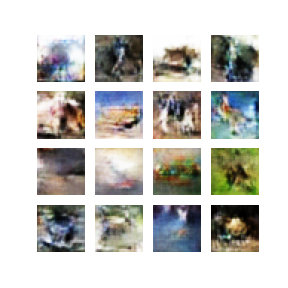

In [14]:
# 최종 샘플 이미지
sample_images = sorted(glob.glob(os.path.join(sample_dir, '*.png')))
if sample_images:
    display(Image(filename=sample_images[-1]))
else:
    print("❌ No sample images found.")

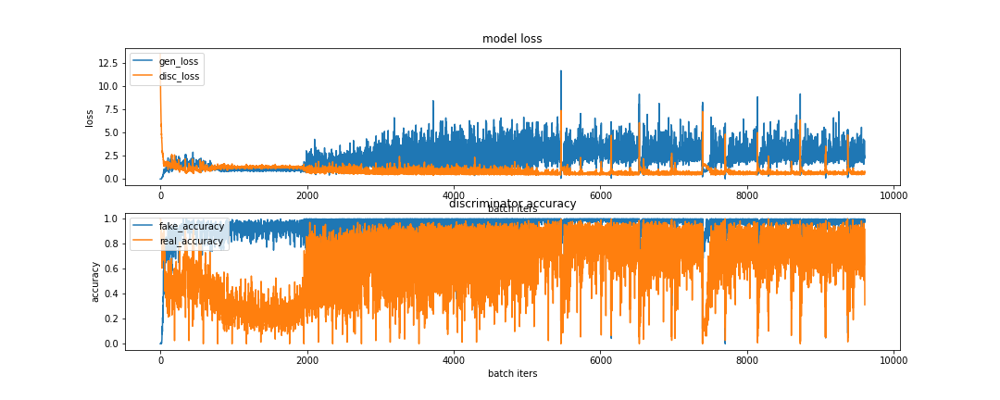

In [15]:
# 최종 학습 그래프 이미지
history_images = sorted(glob.glob(os.path.join(history_dir, '*.png')))
if history_images:
    display(Image(filename=history_images[-1]))
else:
    print("❌ No training history images found.")